In [ ]:
import pandas as pd
import numpy as np
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2, f_classif
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVR
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.decomposition import PCA

In [ ]:
df = pd.read_csv("balanced_bank_preprocessed.csv")
del df['id']

In [ ]:
df.head()

,age,job_cl,marital_cl,education_cl,default_cl,housing_cl,loan_cl,contact_cl,month_cl,day_of_week_cl,...,campaign,pdays,previous,poutcome_cl,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y_cl
0,35,0,1,0,0,0,0,0,2,3,...,1,999,1,1,-1.8,92.893,-46.2,1.266,5099.1,0
1,42,2,0,3,0,1,0,1,2,1,...,1,999,0,0,1.1,93.994,-36.4,4.857,5191.0,1
2,36,0,0,0,0,1,0,0,5,0,...,2,999,0,0,1.4,93.444,-36.1,4.965,5228.1,1
3,37,0,0,1,0,0,1,1,4,2,...,2,999,0,0,1.4,93.918,-42.7,4.963,5228.1,1
4,31,4,1,0,0,0,0,0,1,3,...,1,999,0,0,-1.8,93.075,-47.1,1.365,5099.1,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9280 entries, 0 to 9279
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             9280 non-null   int64  
 1   job_cl          9280 non-null   int64  
 2   marital_cl      9280 non-null   int64  
 3   education_cl    9280 non-null   int64  
 4   default_cl      9280 non-null   int64  
 5   housing_cl      9280 non-null   int64  
 6   loan_cl         9280 non-null   int64  
 7   contact_cl      9280 non-null   int64  
 8   month_cl        9280 non-null   int64  
 9   day_of_week_cl  9280 non-null   int64  
 10  duration        9280 non-null   int64  
 11  campaign        9280 non-null   int64  
 12  pdays           9280 non-null   int64  
 13  previous        9280 non-null   int64  
 14  poutcome_cl     9280 non-null   int64  
 15  emp.var.rate    9280 non-null   float64
 16  cons.price.idx  9280 non-null   float64
 17  cons.conf.idx   9280 non-null   f

In [ ]:
X = df.iloc[:, :-1].values
y = df["y_cl"]

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [ ]:
from sklearn.naive_bayes import GaussianNB

clf = GaussianNB()
clf.fit(X_train, y_train)

GaussianNB()

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

y_pred = clf.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))
print(clf.score(X_test, y_test))

[[942 226]
 [307 845]]
              precision    recall  f1-score   support

           0       0.75      0.81      0.78      1168
           1       0.79      0.73      0.76      1152

    accuracy                           0.77      2320
   macro avg       0.77      0.77      0.77      2320
weighted avg       0.77      0.77      0.77      2320

0.7702586206896552


In [ ]:
from sklearn import svm

clf = svm.SVC()
clf.fit(X_train, y_train)

SVC()

In [ ]:
y_pred = clf.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))
print(clf.score(X_test, y_test))

[[ 977  191]
 [ 111 1041]]
              precision    recall  f1-score   support

           0       0.90      0.84      0.87      1168
           1       0.84      0.90      0.87      1152

    accuracy                           0.87      2320
   macro avg       0.87      0.87      0.87      2320
weighted avg       0.87      0.87      0.87      2320

0.8698275862068966


In [35]:
array = df.values
X = array[:, :-1]
y = array[:, 19]

test = SelectKBest(score_func=f_classif, k=3)
fit = test.fit(X, y)

np.set_printoptions(precision=3)
print(fit.scores_)
features = fit.transform(X)

print(X)
print(features[0:3,:])

#8 18 19 - good

[ 2.418e+01  1.196e+01  4.839e+00  1.101e+01  9.369e+01  5.752e+00
  1.172e+00  7.024e+02  9.072e+03  2.148e+00  9.180e+00  5.312e+01
  3.509e+02  4.242e+02  4.437e+02 -1.833e+16  4.861e+03  3.275e+03
  3.422e+05  5.724e+12]
[[ 3.500e+01  0.000e+00  1.000e+00 ... -4.620e+01  1.266e+00  5.099e+03]
 [ 4.200e+01  2.000e+00  0.000e+00 ... -3.640e+01  4.857e+00  5.191e+03]
 [ 3.600e+01  0.000e+00  0.000e+00 ... -3.610e+01  4.965e+00  5.228e+03]
 ...
 [ 3.800e+01  1.000e+00  0.000e+00 ... -4.710e+01  1.405e+00  5.099e+03]
 [ 4.100e+01  2.000e+00  1.000e+00 ... -4.270e+01  4.962e+00  5.228e+03]
 [ 5.600e+01  3.000e+00  0.000e+00 ... -4.270e+01  4.962e+00  5.228e+03]]
[[2.000e+00 1.266e+00 5.099e+03]
 [2.000e+00 4.857e+00 5.191e+03]
 [5.000e+00 4.965e+00 5.228e+03]]


In [36]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9280 entries, 0 to 9279
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             9280 non-null   int64  
 1   job_cl          9280 non-null   int64  
 2   marital_cl      9280 non-null   int64  
 3   education_cl    9280 non-null   int64  
 4   default_cl      9280 non-null   int64  
 5   housing_cl      9280 non-null   int64  
 6   loan_cl         9280 non-null   int64  
 7   contact_cl      9280 non-null   int64  
 8   month_cl        9280 non-null   int64  
 9   day_of_week_cl  9280 non-null   int64  
 10  duration        9280 non-null   int64  
 11  campaign        9280 non-null   int64  
 12  pdays           9280 non-null   int64  
 13  previous        9280 non-null   int64  
 14  poutcome_cl     9280 non-null   int64  
 15  emp.var.rate    9280 non-null   float64
 16  cons.price.idx  9280 non-null   float64
 17  cons.conf.idx   9280 non-null   f

In [37]:
c = ['age', 'job_cl', 'marital_cl', 'education_cl', 'default_cl', 'housing_cl', 'loan_cl', 'contact_cl', 'day_of_week_cl',
     'duration', 'campaign', 'pdays', 'previous', 'poutcome_cl', 'emp.var.rate', 'cons.price.idx', 'cons.conf.idx']
df1 = df.drop(c, axis = 1)

In [38]:
df1.head()

,month_cl,euribor3m,nr.employed,y_cl
0,2,1.266,5099.1,0
1,2,4.857,5191.0,1
2,5,4.965,5228.1,1
3,4,4.963,5228.1,1
4,1,1.365,5099.1,0


In [39]:
X = df1.iloc[:, :-1].values
y = df1["y_cl"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)
scaler = StandardScaler()
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

clf = GaussianNB()
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))
print(clf.score(X_test, y_test))

[[843 321]
 [315 841]]
              precision    recall  f1-score   support

           0       0.73      0.72      0.73      1164
           1       0.72      0.73      0.73      1156

    accuracy                           0.73      2320
   macro avg       0.73      0.73      0.73      2320
weighted avg       0.73      0.73      0.73      2320

0.7258620689655172


In [40]:
clf = svm.SVC()
clf.fit(X_train, y_train)

SVC()

In [41]:
y_pred = clf.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))
print(clf.score(X_test, y_test))

[[842 322]
 [305 851]]
              precision    recall  f1-score   support

           0       0.73      0.72      0.73      1164
           1       0.73      0.74      0.73      1156

    accuracy                           0.73      2320
   macro avg       0.73      0.73      0.73      2320
weighted avg       0.73      0.73      0.73      2320

0.7297413793103448


In [42]:
X = df1.iloc[:, :-1].values
y = df1["y_cl"]
estimator = SVR(kernel="linear")
rfe = RFE(estimator, n_features_to_select=3, step=1)
rfe = rfe.fit(X, y)
print(rfe.n_features_)
print(rfe.support_)
print(rfe.ranking_)
#month, temperature, ISI
df.head()

3
[ True  True  True]
[1 1 1]


,age,job_cl,marital_cl,education_cl,default_cl,housing_cl,loan_cl,contact_cl,month_cl,day_of_week_cl,...,campaign,pdays,previous,poutcome_cl,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y_cl
0,35,0,1,0,0,0,0,0,2,3,...,1,999,1,1,-1.8,92.893,-46.2,1.266,5099.1,0
1,42,2,0,3,0,1,0,1,2,1,...,1,999,0,0,1.1,93.994,-36.4,4.857,5191.0,1
2,36,0,0,0,0,1,0,0,5,0,...,2,999,0,0,1.4,93.444,-36.1,4.965,5228.1,1
3,37,0,0,1,0,0,1,1,4,2,...,2,999,0,0,1.4,93.918,-42.7,4.963,5228.1,1
4,31,4,1,0,0,0,0,0,1,3,...,1,999,0,0,-1.8,93.075,-47.1,1.365,5099.1,0


In [43]:
df1 = df.drop(['age', 'job_cl', 'marital_cl', 'education_cl', 'default_cl', 'housing_cl', 'loan_cl', 'contact_cl', 'day_of_week_cl',
     'duration', 'campaign', 'pdays', 'previous', 'poutcome_cl', 'emp.var.rate', 'cons.price.idx', 'cons.conf.idx'], axis=1)

In [44]:
df1.head()

,month_cl,euribor3m,nr.employed,y_cl
0,2,1.266,5099.1,0
1,2,4.857,5191.0,1
2,5,4.965,5228.1,1
3,4,4.963,5228.1,1
4,1,1.365,5099.1,0


In [45]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)
scaler = StandardScaler()
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

clf = GaussianNB()
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))
print(clf.score(X_test, y_test))

[[849 316]
 [291 864]]
              precision    recall  f1-score   support

           0       0.74      0.73      0.74      1165
           1       0.73      0.75      0.74      1155

    accuracy                           0.74      2320
   macro avg       0.74      0.74      0.74      2320
weighted avg       0.74      0.74      0.74      2320

0.7383620689655173


In [46]:
clf = svm.SVC() #векторный метод
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))
print(clf.score(X_test, y_test))

[[847 318]
 [285 870]]
              precision    recall  f1-score   support

           0       0.75      0.73      0.74      1165
           1       0.73      0.75      0.74      1155

    accuracy                           0.74      2320
   macro avg       0.74      0.74      0.74      2320
weighted avg       0.74      0.74      0.74      2320

0.7400862068965517


In [47]:
model = ExtraTreesClassifier()
model.fit(X, y)
print(model.feature_importances_)
#8 18 19
df.head()

[0.109 0.544 0.347]


,age,job_cl,marital_cl,education_cl,default_cl,housing_cl,loan_cl,contact_cl,month_cl,day_of_week_cl,...,campaign,pdays,previous,poutcome_cl,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y_cl
0,35,0,1,0,0,0,0,0,2,3,...,1,999,1,1,-1.8,92.893,-46.2,1.266,5099.1,0
1,42,2,0,3,0,1,0,1,2,1,...,1,999,0,0,1.1,93.994,-36.4,4.857,5191.0,1
2,36,0,0,0,0,1,0,0,5,0,...,2,999,0,0,1.4,93.444,-36.1,4.965,5228.1,1
3,37,0,0,1,0,0,1,1,4,2,...,2,999,0,0,1.4,93.918,-42.7,4.963,5228.1,1
4,31,4,1,0,0,0,0,0,1,3,...,1,999,0,0,-1.8,93.075,-47.1,1.365,5099.1,0


In [48]:
df1 = df.drop(['age', 'job_cl', 'marital_cl', 'education_cl', 'default_cl', 'housing_cl', 'loan_cl', 'contact_cl', 'day_of_week_cl',
     'duration', 'campaign', 'pdays', 'previous', 'poutcome_cl', 'emp.var.rate', 'cons.price.idx', 'cons.conf.idx'], axis=1)
df1.head()

,month_cl,euribor3m,nr.employed,y_cl
0,2,1.266,5099.1,0
1,2,4.857,5191.0,1
2,5,4.965,5228.1,1
3,4,4.963,5228.1,1
4,1,1.365,5099.1,0


In [49]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)
scaler = StandardScaler()
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

clf = GaussianNB()
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))
print(clf.score(X_test, y_test))

[[863 323]
 [319 815]]
              precision    recall  f1-score   support

           0       0.73      0.73      0.73      1186
           1       0.72      0.72      0.72      1134

    accuracy                           0.72      2320
   macro avg       0.72      0.72      0.72      2320
weighted avg       0.72      0.72      0.72      2320

0.7232758620689655


In [50]:
pca = PCA(n_components=3)
fit = pca.fit(X)
features = fit.transform(X)

print(fit.explained_variance_ratio_)
print(features[0:3, :])

[9.993e-01 6.453e-04 4.932e-05]
[[ 3.644e+01 -1.794e+00 -8.036e-01]
 [-5.552e+01 -1.598e+00  8.975e-01]
 [-9.261e+01  1.352e+00 -1.446e-02]]


In [51]:
d = pd.DataFrame(features, columns=['Feature 1', 'Feature 2', 'Feature 3'])

In [52]:
d.shape

(9280, 3)

In [53]:
d.head()

,Feature 1,Feature 2,Feature 3
0,36.437270,-1.793661,-0.803648
1,-55.516920,-1.598161,0.897526
2,-92.609874,1.351874,-0.014459
3,-92.610332,0.355534,0.071046
4,36.434747,-2.781164,-0.617552


In [54]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25)
scaler = StandardScaler()
scaler.fit(X_train)

X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

clf = GaussianNB()
clf.fit(X_train, y_train)

y_pred = clf.predict(X_test)
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))
print(clf.score(X_test, y_test))

[[824 320]
 [345 831]]
              precision    recall  f1-score   support

           0       0.70      0.72      0.71      1144
           1       0.72      0.71      0.71      1176

    accuracy                           0.71      2320
   macro avg       0.71      0.71      0.71      2320
weighted avg       0.71      0.71      0.71      2320

0.7133620689655172


#Task 2

In [55]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

In [56]:
model = KMeans(n_clusters = 2)

In [57]:
model.fit(df)

KMeans(n_clusters=2)

In [58]:
from scipy.cluster.hierarchy import linkage, dendrogram
import matplotlib.pyplot as plt

%config InlineBackend.figure_format = 'svg' 

In [59]:
v = list(X)
s = df.values
m = linkage(s, method='complete')
dendrogram(m,
           labels=v,
           leaf_rotation=0,
           leaf_font_size=6,
           )

plt.show()

/usr/local/lib/python3.7/dist-packages/matplotlib/text.py:1165: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if s != self._text:


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


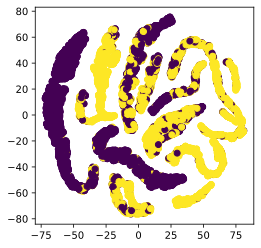

In [60]:
from sklearn import datasets
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

model = TSNE(learning_rate=100)

transformed = model.fit_transform(df)

x_axis = transformed[:, 0]
y_axis = transformed[:, 1]

plt.subplot(aspect='equal')
plt.scatter(x_axis, y_axis, c=y)
plt.show()

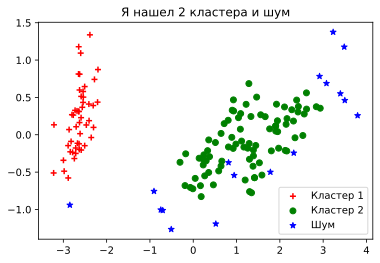

In [61]:
from sklearn.datasets import load_iris
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA

iris = load_iris()

dbscan = DBSCAN()

dbscan.fit(iris.data)

pca = PCA(n_components=2).fit(iris.data)
pca_2d = pca.transform(iris.data)

for i in range(0, pca_2d.shape[0]):
    if dbscan.labels_[i] == 0:
        c1 = plt.scatter(pca_2d[i, 0], pca_2d[i, 1], c='r', marker='+')
    elif dbscan.labels_[i] == 1:
        c2 = plt.scatter(pca_2d[i, 0], pca_2d[i, 1], c='g', marker='o')
    elif dbscan.labels_[i] == -1:
        c3 = plt.scatter(pca_2d[i, 0], pca_2d[i, 1], c='b', marker='*')

plt.legend([c1, c2, c3], ['Кластер 1', 'Кластер 2', 'Шум'])
plt.title('Я нашел 2 кластера и шум')
plt.show()